# Overview
This file documents the process of building the code necessary to take predictions from a trained `torch` neural network and format the results so that they may be stored in a container. At first the choice of container will be restricted to `pandas.Dataframe` only. 

## Load Model Dictionary

In [10]:
import torchvision
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection.mask_rcnn import MaskRCNNPredictor

      
def get_instance_segmentation_model(num_classes):
    # load an instance segmentation model pre-trained on COCO
    model = torchvision.models.detection.maskrcnn_resnet50_fpn(pretrained=True)

    # get the number of input features for the classifier
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    # replace the pre-trained head with a new one
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

    # now get the number of input features for the mask classifier
    in_features_mask = model.roi_heads.mask_predictor.conv5_mask.in_channels
    hidden_layer = 256
    # and replace the mask predictor with a new one
    model.roi_heads.mask_predictor = MaskRCNNPredictor(in_features_mask,
                                                       hidden_layer,
                                                       num_classes)

    return model

In [11]:
import torch


state_dict = r'../../model_dict/maskrcnn_resnet50_state_dict.pth'

model = get_instance_segmentation_model(2)
model.load_state_dict(torch.load(state_dict))

<All keys matched successfully>

In [12]:
device = torch.device('cuda')

In [13]:
model.to(device)

MaskRCNN(
  (transform): GeneralizedRCNNTransform()
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d()
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d()
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d()
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d()
          (relu): ReLU(inplace=True)
          (downsample): Sequential(
            (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
            (1): FrozenBatchNorm2d()
          )
    

## Download Imagery

In [9]:
import os
import errno
import json
import gdal
import numpy as np

from googleapiclient.http import MediaFileUpload

from google.cloud import storage
from skimage.io import imread

# Create the service client.
from googleapiclient.discovery import build
from apiclient.http import MediaIoBaseDownload

In [13]:
# GOOGLE CREDS is different for notebook – change for .py files
GOOGLE_APPLICATION_CREDENTIALS = os.getenv('GOOGLE_APPLICATION_CREDENTIALS')
BUCKET_NAME = os.getenv('BUCKET_NAME')
GEO_FILTER_PATH = os.getenv('GEO_FILTER_PATH')
PATH_PREFIX = os.getenv('PATH_PREFIX')
ORDER_ID = os.getenv('ORDER_ID')
ITEM_TYPE = os.getenv('ITEM_TYPE')
ITEM_ID_PATH = os.getenv('ITEM_ID_PATH')
DL_IMAGE_PATH = os.getenv('DL_IMAGE_PATH')
BAND_ID = os.getenv('BAND_ID')

In [14]:
BUCKET_NAME

'planet_imagery'

In [15]:
def download_img(dl_path, id_num):
    gcs_service = build('storage', 'v1')
    if not os.path.exists(os.path.dirname(dl_path)):
        try:
            os.makedirs(os.path.dirname(dl_path))
        except OSError as exc: # Guard against race condition
            if exc.errno != errno.EEXIST:
                raise
    with open(dl_path, 'wb') as f:
      # Download the file from the Google Cloud Storage bucket.
      request = gcs_service.objects().get_media(bucket=BUCKET_NAME,
                                                object=dl_path)
      media = MediaIoBaseDownload(f, request)
      print('Downloading image ', id_num, '...')
      print('Download Progress: ')
      done = False
      while not done:
          prog, done = media.next_chunk()
          print(prog.progress())

    print('Image ', id_num, ' downloaded.')
    return dl_path

In [16]:
dl_path = r'lima/2a2ca315-88af-4c4f-be1d-befdab5ce7fa/PSScene4Band/20161204_181909_0d06_3B_AnalyticMS.tif'
filepath = download_img(dl_path, id_num=0)

Download Progress: 
1.0
Image  0  downloaded.


In [17]:
dl_path_cropped = r'lima/2a2ca315-88af-4c4f-be1d-befdab5ce7fa/clipped/PSScene4Band/20161216_133244_0c42_3B_AnalyticMS.tif'
filepath_cropped = download_img(dl_path_cropped, id_num=1)

Download Progress: 
1.0
Image  1  downloaded.


## Convert Image To Array

In [17]:
import numpy as np
from osgeo import gdal

In [18]:
filepath = r'lima/2a2ca315-88af-4c4f-be1d-befdab5ce7fa/PSScene4Band/20161204_181909_0d06_3B_AnalyticMS.tif'
ds = gdal.Translate('',
               filepath,
               options='-ot Byte -scale minval maxval -of MEM')
b1, b2, b3, b4 = (ds.GetRasterBand(1).ReadAsArray(), ds.GetRasterBand(2).ReadAsArray(),
                  ds.GetRasterBand(3).ReadAsArray(), ds.GetRasterBand(4).ReadAsArray())
img = np.array((b3,b2,b1))
img = np.moveaxis(img, 0, 2)
img.shape

(5534, 6546, 3)

In [19]:
filepath_cropped = r'lima/2a2ca315-88af-4c4f-be1d-befdab5ce7fa/clipped/PSScene4Band/20161216_133244_0c42_3B_AnalyticMS.tif'
ds = gdal.Translate('',
               filepath_cropped,
               options='-ot Byte -scale minval maxval -of MEM')
b1, b2, b3, b4 = (ds.GetRasterBand(1).ReadAsArray(), ds.GetRasterBand(2).ReadAsArray(),
                  ds.GetRasterBand(3).ReadAsArray(), ds.GetRasterBand(4).ReadAsArray())
img_cropped = np.array((b3,b2,b1))
img_cropped = np.moveaxis(img_cropped, 0, 2)
img_cropped.shape

(175, 201, 3)

## Image Preprocessing

In [44]:
# Pad Target Image
z_pad = np.zeros((300,300,3), dtype=np.uint8)

# Get coordinates
x_start = int((z_pad.shape[0] - img_cropped.shape[0]) / 2)
x_end = x_start + img_cropped.shape[0]
y_start = int((z_pad.shape[1] - img_cropped.shape[1]) / 2)
y_end = y_start + img_cropped.shape[1]
z_pad[x_start:x_end, y_start:y_end, :] = img_cropped

In [76]:
from skimage.filters import gaussian

In [85]:
# Extract gaussian filter
gauss_img = gaussian(img_cropped, multichannel=True)
gauss_img

array([[[0.00162265, 0.00242349, 0.00077869],
        [0.00238161, 0.00379652, 0.00127687],
        [0.00255713, 0.00455439, 0.00259732],
        ...,
        [0.05552318, 0.08088997, 0.07962422],
        [0.02390059, 0.03485665, 0.0344404 ],
        [0.00465946, 0.00680136, 0.00673234]],

       [[0.00544573, 0.0083676 , 0.00388406],
        [0.00622771, 0.01019508, 0.00446207],
        [0.00590519, 0.01093443, 0.00679349],
        ...,
        [0.05612124, 0.08257203, 0.07687866],
        [0.02424738, 0.03575493, 0.03324861],
        [0.00473428, 0.00699247, 0.00649912]],

       [[0.00998199, 0.01577702, 0.01036536],
        [0.00951154, 0.01599801, 0.0100685 ],
        [0.00791331, 0.01528894, 0.01172525],
        ...,
        [0.05575603, 0.08260032, 0.07285208],
        [0.02417375, 0.03586435, 0.03148925],
        [0.00472795, 0.00702221, 0.00615392]],

       ...,

       [[0.01009455, 0.01751458, 0.01582962],
        [0.0239651 , 0.04103337, 0.03755974],
        [0.03203685, 0

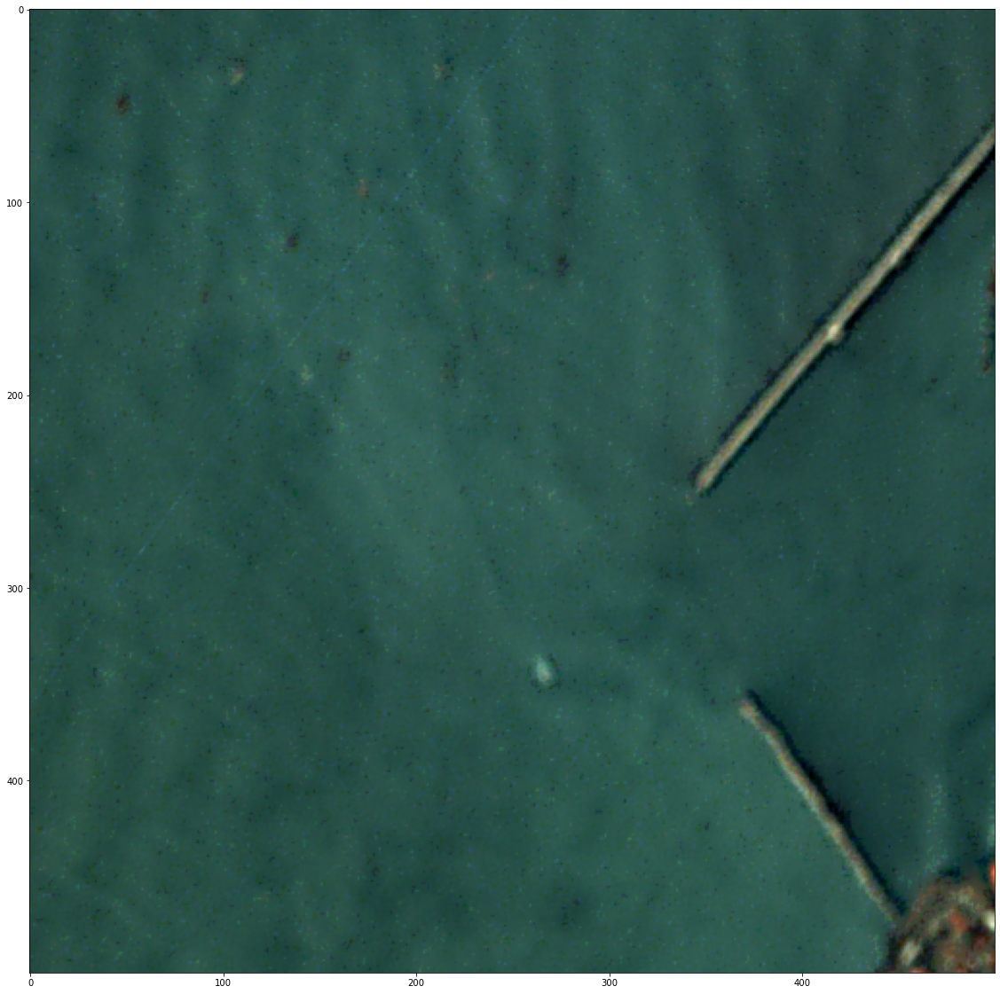

In [135]:
from PIL import Image, ImageFilter


# with PIL
im = Image.fromarray(img[1250:1750,750:1250,:])
im2 = im.filter(ImageFilter.UnsharpMask(radius=3.0, percent=300))

img_cropped_2 = np.array(im2)

plt.figure(figsize=(20,20))
plt.imshow(img_cropped_2)

## Get Predictions

In [136]:
from torchvision.transforms import functional as F
img_crop = img_cropped_2

image = F.to_tensor(img_crop)
model.eval()
with torch.no_grad():
    #prediction = model([img_torch.to(device)])
    prediction = model([(image).to(device)])

In [137]:
prediction[0]

{'boxes': tensor([[260.5373, 337.5128, 274.7086, 354.1758]], device='cuda:0'),
 'labels': tensor([1], device='cuda:0'),
 'scores': tensor([0.0523], device='cuda:0'),
 'masks': tensor([[[[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           ...,
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.]]]], device='cuda:0')}

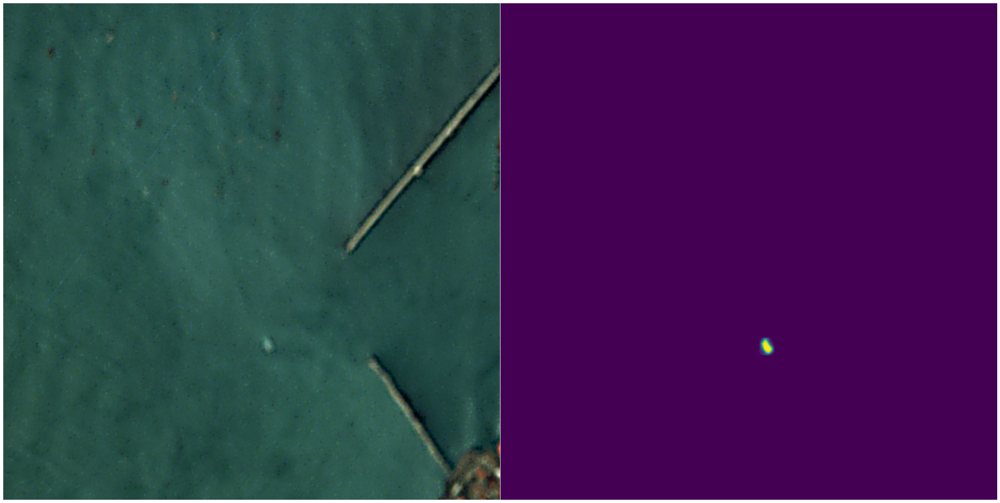

In [138]:
import matplotlib.pyplot as plt
from PIL import Image


#img = Image.fromarray(np.array((img_array[0, :, :, None]), dtype=int))

n_pos = len(prediction[0]['scores'][(prediction[0]['scores'] > 0.00)])

masks = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
for mask in prediction[0]['masks'][1:n_pos, 0]:
    masks += mask.mul(255).byte().cpu().numpy()

fig, axarr = plt.subplots(1, 2, figsize=(30, 80))
axarr[0].axis('off')
axarr[1].axis('off')
#axarr[2].axis('off')
#axarr[3].axis('off')
axarr[0].imshow(Image.fromarray(img_crop))#, cmap='Blues')
axarr[1].imshow(Image.fromarray(masks))
#axarr[2].imshow(img)
#axarr[2].imshow(all_masks, alpha=0.4)
#axarr[3].imshow(first_mask)
plt.tight_layout(h_pad=0.1, w_pad=0.1)
plt.show()

## Process Predictions

In [272]:
prediction[0]

{'boxes': tensor([[ 373.6232,  497.8856,  389.9562,  557.4059],
         [ 560.1738,  417.6650,  574.3972,  468.2657],
         [ 196.9163,  473.6738,  215.4731,  533.7964],
         [1071.9982,  898.3463, 1088.0229,  915.8585]], device='cuda:0'),
 'labels': tensor([1, 1, 1, 1], device='cuda:0'),
 'scores': tensor([0.9936, 0.6882, 0.6730, 0.1237], device='cuda:0'),
 'masks': tensor([[[[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           ...,
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.]]],
 
 
         [[[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           ...,
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 0.,  ..., 0., 0., 0.]]],
 
 
         [[[0., 0., 0.,  ..., 0., 0., 0.],
           [0., 0., 

In [299]:
scores = prediction[0]['scores'].cpu().numpy()

scores_filtered = scores[scores >= 0.5]
print(scores.shape)
print(scores_filtered.shape)
indices = np.where(scores >= 0.5)[0]
boxes = prediction[0]['boxes']
boxes[indices].cpu().numpy()
boxes = prediction[0]['boxes'][indices].cpu().numpy()

result = np.array([boxes,indices])
result

(4,)
(3,)


ValueError: could not broadcast input array from shape (3,4) into shape (3)

In [ ]:
def select_by_score(prediction, thresh=0.5):
    scores = prediction[0]['scores'].cpu().numpy()
    scores_filtered = scores[scores >= thresh]
    indices = np.where(scores >= thresh)[0]
    boxes = prediction[0]['boxes'][indices].cpu().numpy()

# Image Processing Testing Suite

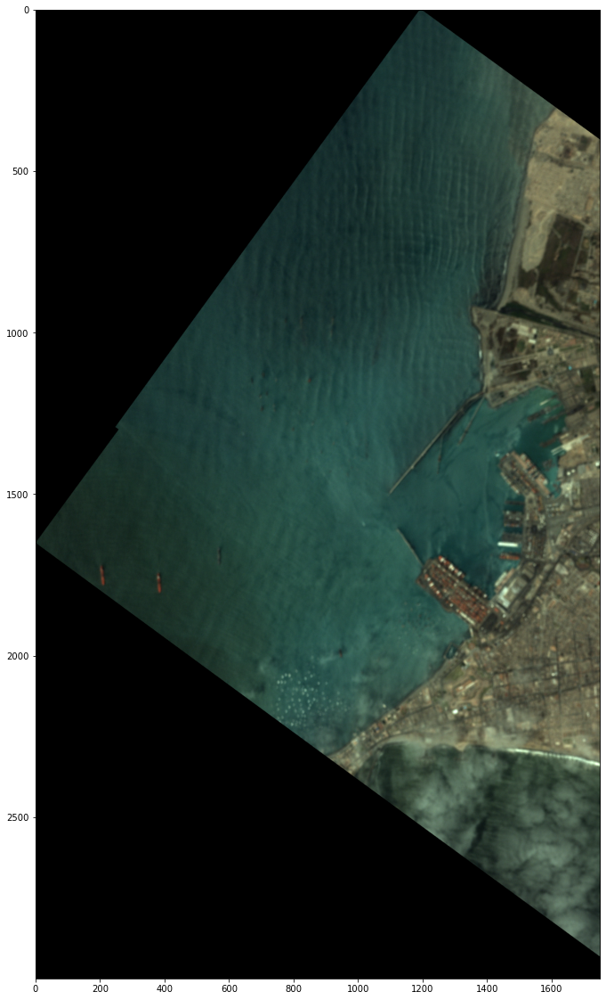

In [142]:
plt.figure(figsize=(20,20))
plt.imshow(img[:3000,:1750,:])

In [155]:
x_start = 0
x_end = 1200
y_start = 1250
y_end = 2250

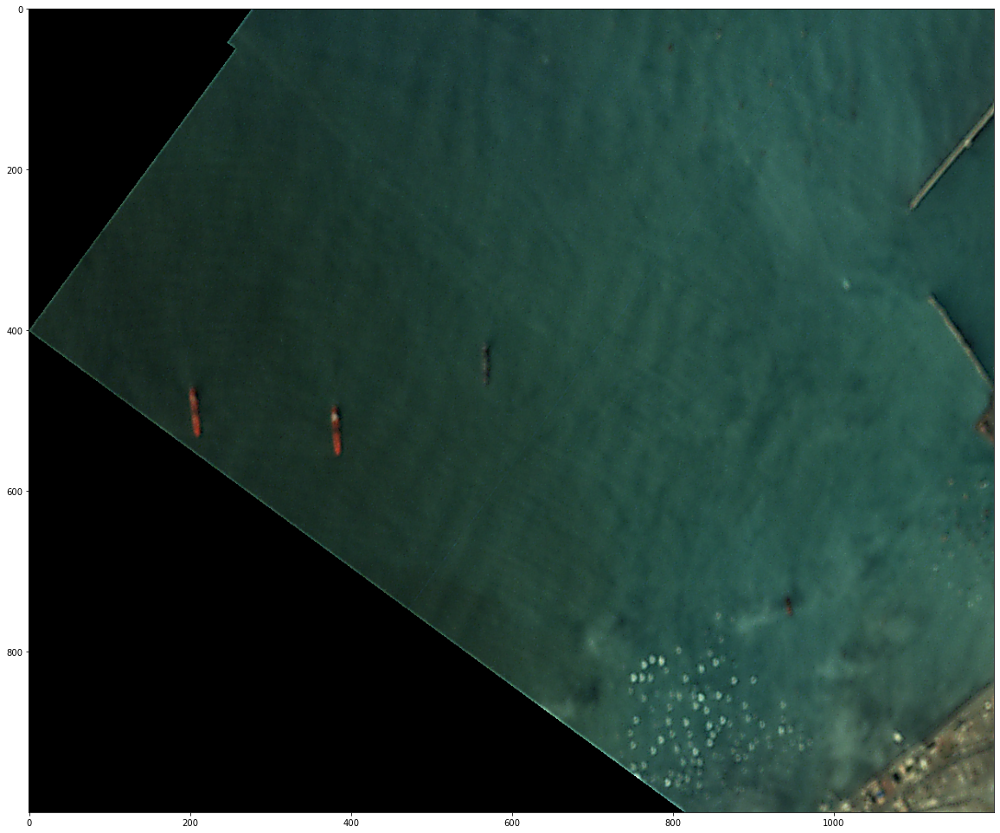

In [164]:
from PIL import Image, ImageFilter

section = img[y_start:y_end, x_start:x_end,:]
# with PIL
im = Image.fromarray(section)
im2 = im.filter(ImageFilter.UnsharpMask(radius=2.0, percent=300))

im_array = np.array(im)
im2_array = np.array(im2)

plt.figure(figsize=(20,20))
plt.imshow(im2_array)

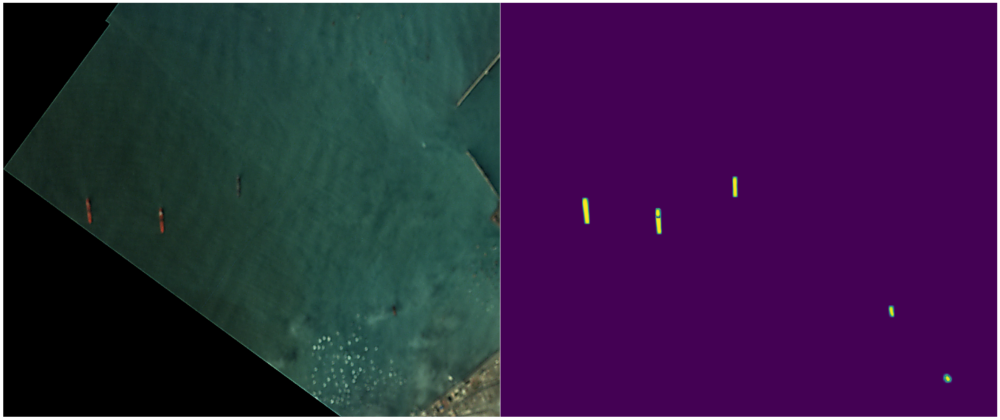

In [165]:
from torchvision.transforms import functional as F
img_crop = im2_array

image = F.to_tensor(img_crop)
model.eval()
with torch.no_grad():
    #prediction = model([img_torch.to(device)])
    prediction = model([(image).to(device)])
    
import matplotlib.pyplot as plt
from PIL import Image


#img = Image.fromarray(np.array((img_array[0, :, :, None]), dtype=int))

n_pos = len(prediction[0]['scores'][(prediction[0]['scores'] > 0.00)])

masks = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
for mask in prediction[0]['masks'][1:n_pos, 0]:
    masks += mask.mul(255).byte().cpu().numpy()

fig, axarr = plt.subplots(1, 2, figsize=(30, 80))
axarr[0].axis('off')
axarr[1].axis('off')
#axarr[2].axis('off')
#axarr[3].axis('off')
axarr[0].imshow(Image.fromarray(img_crop))#, cmap='Blues')
axarr[1].imshow(Image.fromarray(masks))
#axarr[2].imshow(img)
#axarr[2].imshow(all_masks, alpha=0.4)
#axarr[3].imshow(first_mask)
plt.tight_layout(h_pad=0.1, w_pad=0.1)
plt.show()

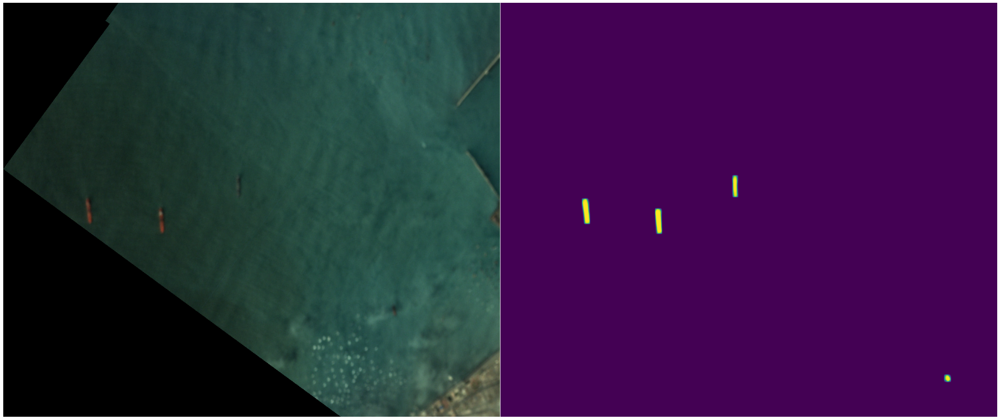

In [158]:
from torchvision.transforms import functional as F
img_crop = im_array

image = F.to_tensor(img_crop)
model.eval()
with torch.no_grad():
    #prediction = model([img_torch.to(device)])
    prediction = model([(image).to(device)])
    
import matplotlib.pyplot as plt
from PIL import Image


#img = Image.fromarray(np.array((img_array[0, :, :, None]), dtype=int))

n_pos = len(prediction[0]['scores'][(prediction[0]['scores'] > 0.00)])

masks = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
for mask in prediction[0]['masks'][1:n_pos, 0]:
    masks += mask.mul(255).byte().cpu().numpy()

fig, axarr = plt.subplots(1, 2, figsize=(30, 80))
axarr[0].axis('off')
axarr[1].axis('off')
#axarr[2].axis('off')
#axarr[3].axis('off')
axarr[0].imshow(Image.fromarray(img_crop))#, cmap='Blues')
axarr[1].imshow(Image.fromarray(masks))
#axarr[2].imshow(img)
#axarr[2].imshow(all_masks, alpha=0.4)
#axarr[3].imshow(first_mask)
plt.tight_layout(h_pad=0.1, w_pad=0.1)
plt.show()

### Test 2

In [183]:
x_start = 700
x_end = 1100
y_start = 1250
y_end = 1650

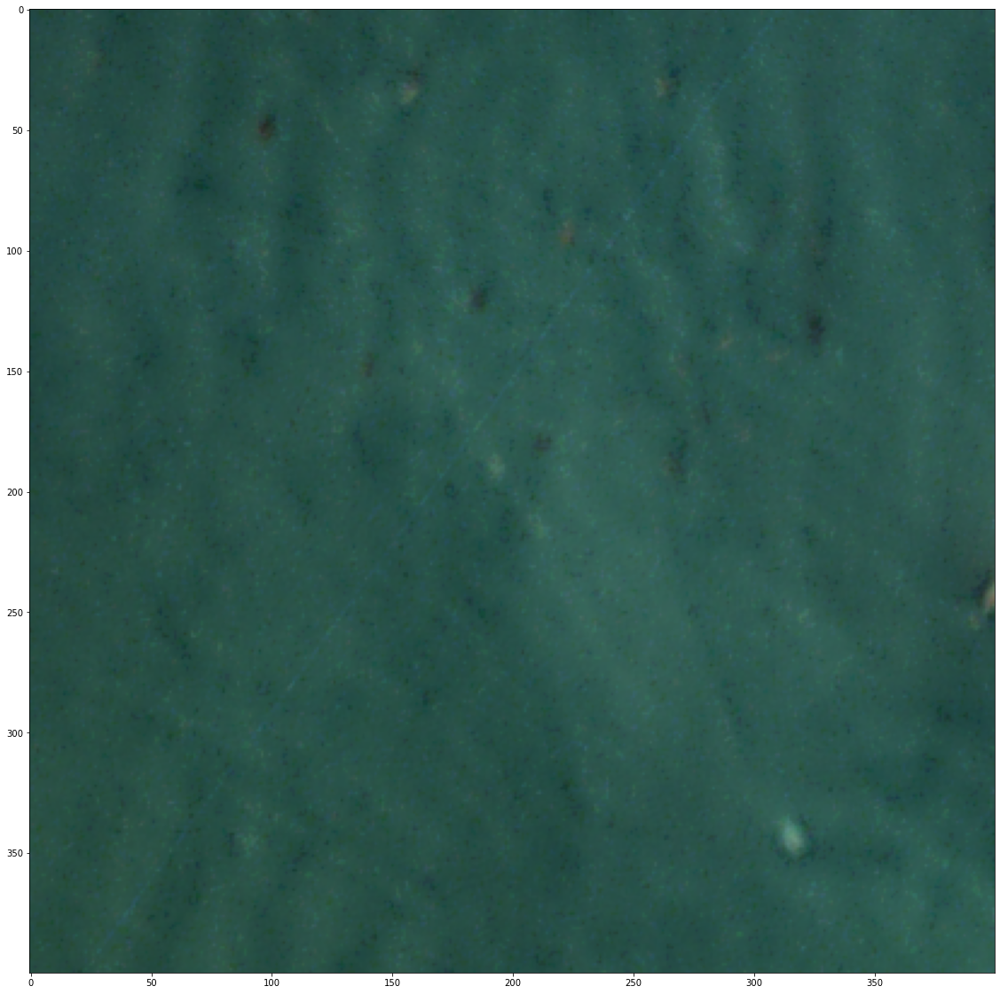

In [188]:
from PIL import Image, ImageFilter

section = img[y_start:y_end, x_start:x_end,:]
# with PIL
im = Image.fromarray(section)
im2 = im.filter(ImageFilter.UnsharpMask(radius=4.0, percent=150))

im_array = np.array(im)
im2_array = np.array(im2)

plt.figure(figsize=(20,20))
plt.imshow(im2_array)

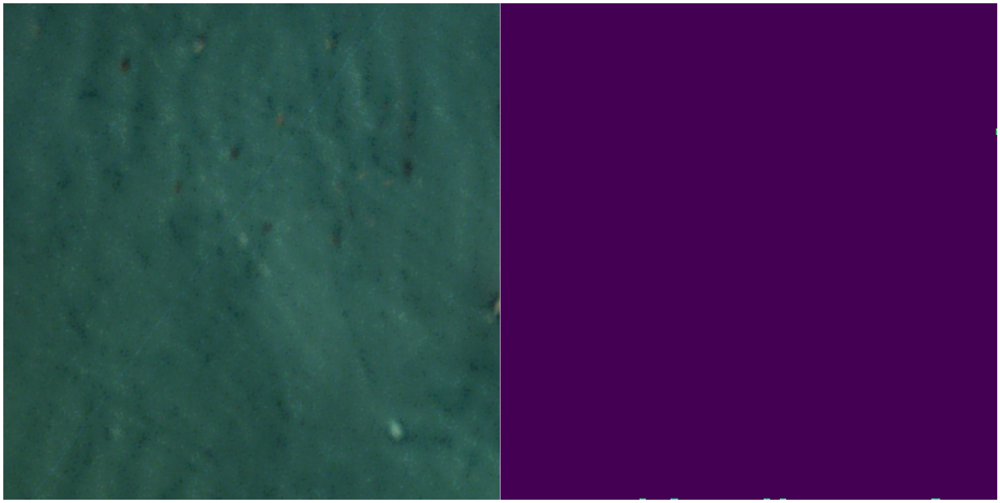

In [187]:
from torchvision.transforms import functional as F
img_crop = im2_array

image = F.to_tensor(img_crop)
model.eval()
with torch.no_grad():
    #prediction = model([img_torch.to(device)])
    prediction = model([(image).to(device)])
    
import matplotlib.pyplot as plt
from PIL import Image


#img = Image.fromarray(np.array((img_array[0, :, :, None]), dtype=int))

n_pos = len(prediction[0]['scores'][(prediction[0]['scores'] > 0.00)])

masks = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
for mask in prediction[0]['masks'][1:n_pos, 0]:
    masks += mask.mul(255).byte().cpu().numpy()

fig, axarr = plt.subplots(1, 2, figsize=(30, 80))
axarr[0].axis('off')
axarr[1].axis('off')
#axarr[2].axis('off')
#axarr[3].axis('off')
axarr[0].imshow(Image.fromarray(img_crop))#, cmap='Blues')
axarr[1].imshow(Image.fromarray(masks))
#axarr[2].imshow(img)
#axarr[2].imshow(all_masks, alpha=0.4)
#axarr[3].imshow(first_mask)
plt.tight_layout(h_pad=0.1, w_pad=0.1)
plt.show()

In [179]:
from torchvision.transforms import functional as F
img_crop = im_array

image = F.to_tensor(img_crop)
model.eval()
with torch.no_grad():
    #prediction = model([img_torch.to(device)])
    prediction = model([(image).to(device)])
    
import matplotlib.pyplot as plt
from PIL import Image


#img = Image.fromarray(np.array((img_array[0, :, :, None]), dtype=int))

n_pos = len(prediction[0]['scores'][(prediction[0]['scores'] > 0.00)])

masks = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
for mask in prediction[0]['masks'][1:n_pos, 0]:
    masks += mask.mul(255).byte().cpu().numpy()

fig, axarr = plt.subplots(1, 2, figsize=(30, 80))
axarr[0].axis('off')
axarr[1].axis('off')
#axarr[2].axis('off')
#axarr[3].axis('off')
axarr[0].imshow(Image.fromarray(img_crop))#, cmap='Blues')
axarr[1].imshow(Image.fromarray(masks))
#axarr[2].imshow(img)
#axarr[2].imshow(all_masks, alpha=0.4)
#axarr[3].imshow(first_mask)
plt.tight_layout(h_pad=0.1, w_pad=0.1)
plt.show()

IndexError: index 0 is out of bounds for dimension 0 with size 0

### Test 3

In [189]:
def change_contrast(img, level):
    factor = (259 * (level + 255)) / (255 * (259 - level))
    def contrast(c):
        value = 128 + factor * (c - 128)
        return max(0, min(255, value))
    return img.point(contrast)



In [155]:
x_start = 0
x_end = 1200
y_start = 1250
y_end = 2250

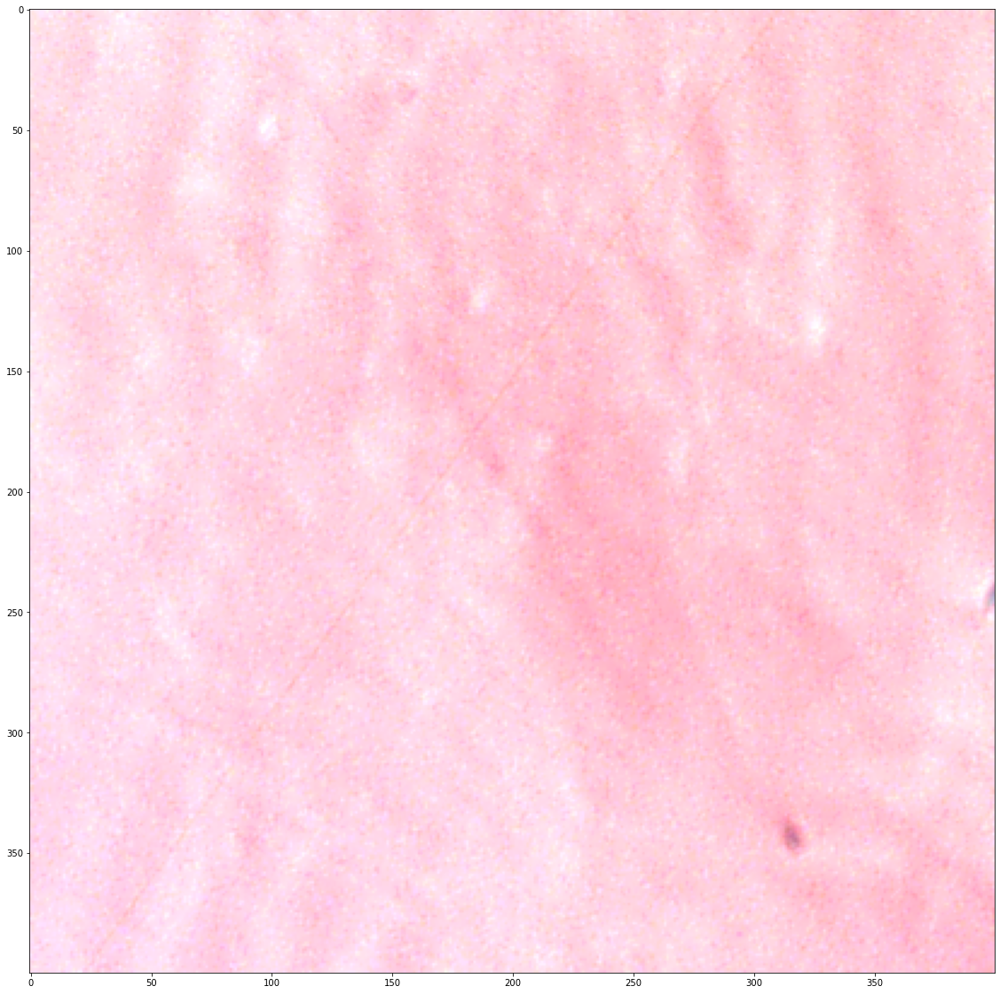

In [204]:
from PIL import Image, ImageFilter

section = img[y_start:y_end, x_start:x_end,:]
# with PIL
im = Image.fromarray(section)

im2 = change_contrast(im, 900)
im2 = im2.filter(ImageFilter.UnsharpMask(radius=2.0, percent=150))

im_array = np.array(im)
im2_array = np.array(im2)

plt.figure(figsize=(20,20))
plt.imshow(im2_array)

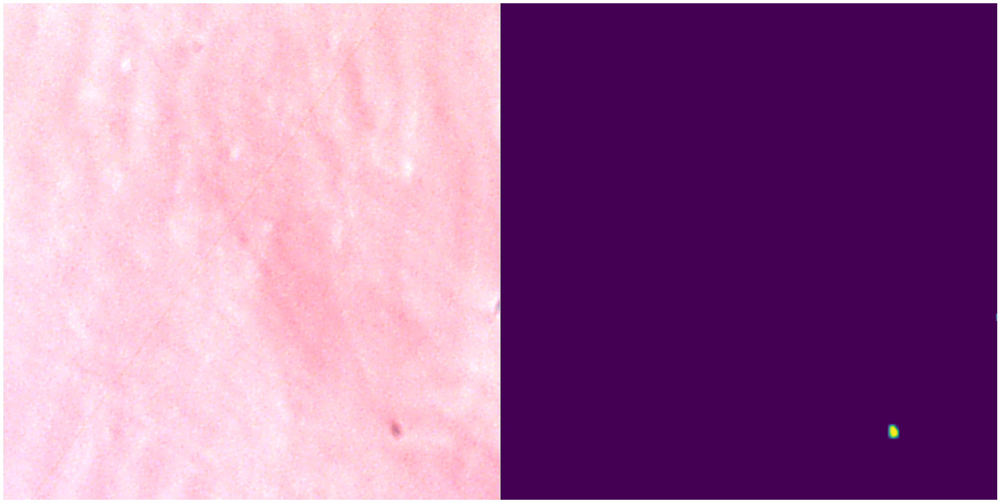

In [205]:
from torchvision.transforms import functional as F
img_crop = im2_array

image = F.to_tensor(img_crop)
model.eval()
with torch.no_grad():
    #prediction = model([img_torch.to(device)])
    prediction = model([(image).to(device)])
    
import matplotlib.pyplot as plt
from PIL import Image


#img = Image.fromarray(np.array((img_array[0, :, :, None]), dtype=int))

n_pos = len(prediction[0]['scores'][(prediction[0]['scores'] > 0.00)])

masks = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
for mask in prediction[0]['masks'][1:n_pos, 0]:
    masks += mask.mul(255).byte().cpu().numpy()

fig, axarr = plt.subplots(1, 2, figsize=(30, 80))
axarr[0].axis('off')
axarr[1].axis('off')
#axarr[2].axis('off')
#axarr[3].axis('off')
axarr[0].imshow(Image.fromarray(img_crop))#, cmap='Blues')
axarr[1].imshow(Image.fromarray(masks))
#axarr[2].imshow(img)
#axarr[2].imshow(all_masks, alpha=0.4)
#axarr[3].imshow(first_mask)
plt.tight_layout(h_pad=0.1, w_pad=0.1)
plt.show()

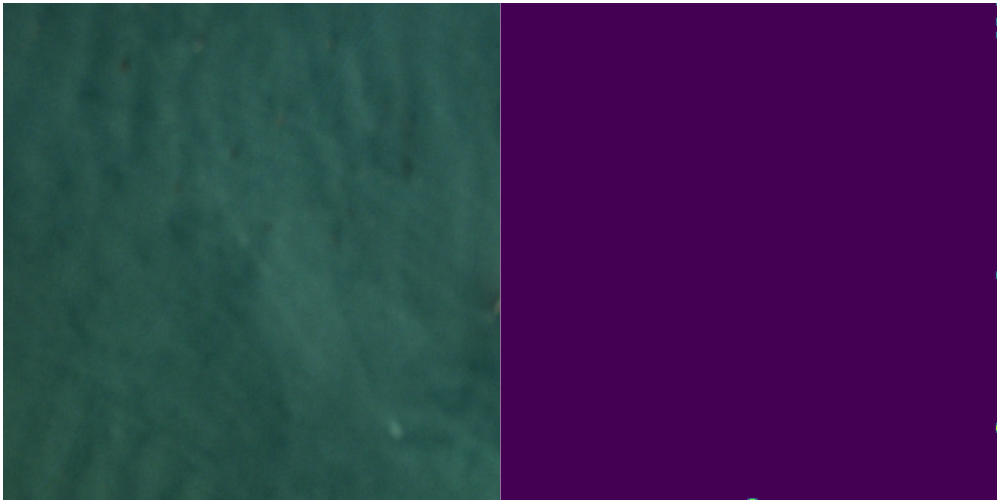

In [218]:
from torchvision.transforms import functional as F
img_crop = im_array

image = F.to_tensor(img_crop)
model.eval()
with torch.no_grad():
    #prediction = model([img_torch.to(device)])
    prediction = model([(image).to(device)])
    
import matplotlib.pyplot as plt
from PIL import Image


#img = Image.fromarray(np.array((img_array[0, :, :, None]), dtype=int))

n_pos = len(prediction[0]['scores'][(prediction[0]['scores'] > 0.00)])

masks = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
for mask in prediction[0]['masks'][1:n_pos, 0]:
    masks += mask.mul(255).byte().cpu().numpy()

fig, axarr = plt.subplots(1, 2, figsize=(30, 80))
axarr[0].axis('off')
axarr[1].axis('off')
#axarr[2].axis('off')
#axarr[3].axis('off')
axarr[0].imshow(Image.fromarray(img_crop))#, cmap='Blues')
axarr[1].imshow(Image.fromarray(masks))
#axarr[2].imshow(img)
#axarr[2].imshow(all_masks, alpha=0.4)
#axarr[3].imshow(first_mask)
plt.tight_layout(h_pad=0.1, w_pad=0.1)
plt.show()

# Choosing Bands
The model clearly prefers vessels which are darker than the surrounding water. Therefore we should choose bands which make vessels show up dark.

In [235]:
filepath = r'lima/2a2ca315-88af-4c4f-be1d-befdab5ce7fa/PSScene4Band/20161204_181909_0d06_3B_AnalyticMS.tif'
ds = gdal.Translate('',
               filepath,
               options='-ot Byte -scale minval maxval -of MEM')

b1, b2, b3, b4 = (ds.GetRasterBand(1).ReadAsArray(), ds.GetRasterBand(2).ReadAsArray(),
                  ds.GetRasterBand(3).ReadAsArray(), ds.GetRasterBand(4).ReadAsArray())
img = np.array((b3,b2,b1))
img = np.moveaxis(img, 0, 2)
img.shape

(5534, 6546, 3)

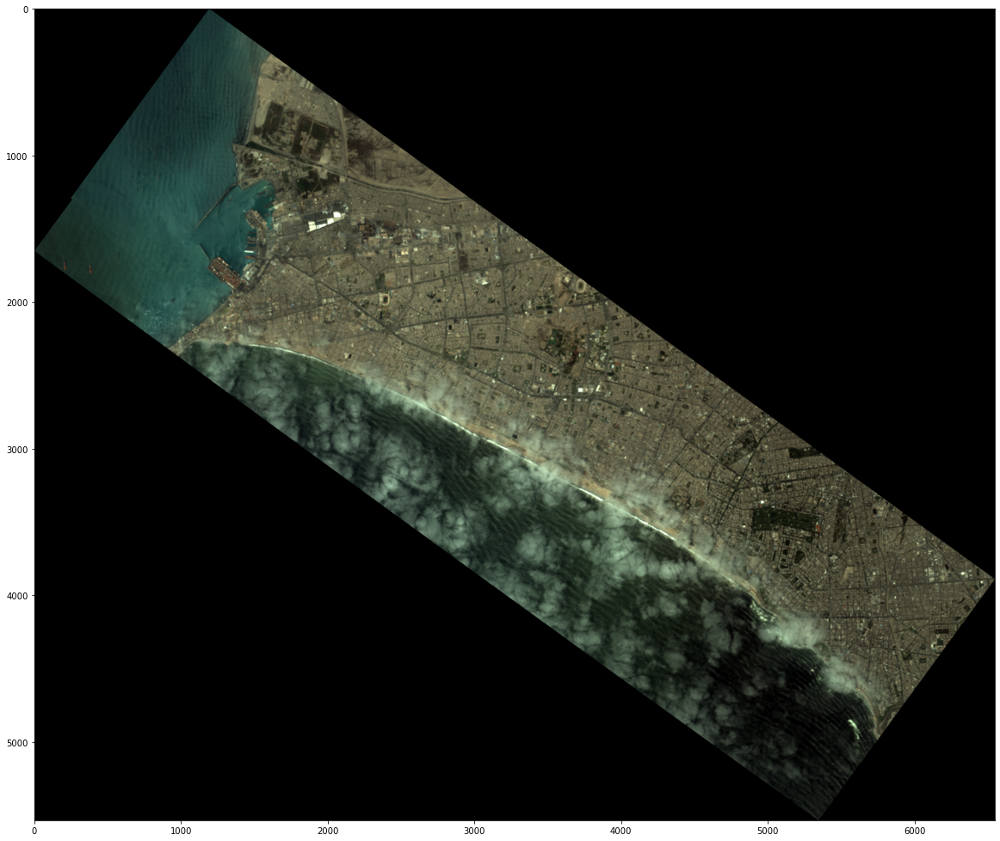

In [236]:
plt.figure(figsize=(20,20))
plt.imshow(img)

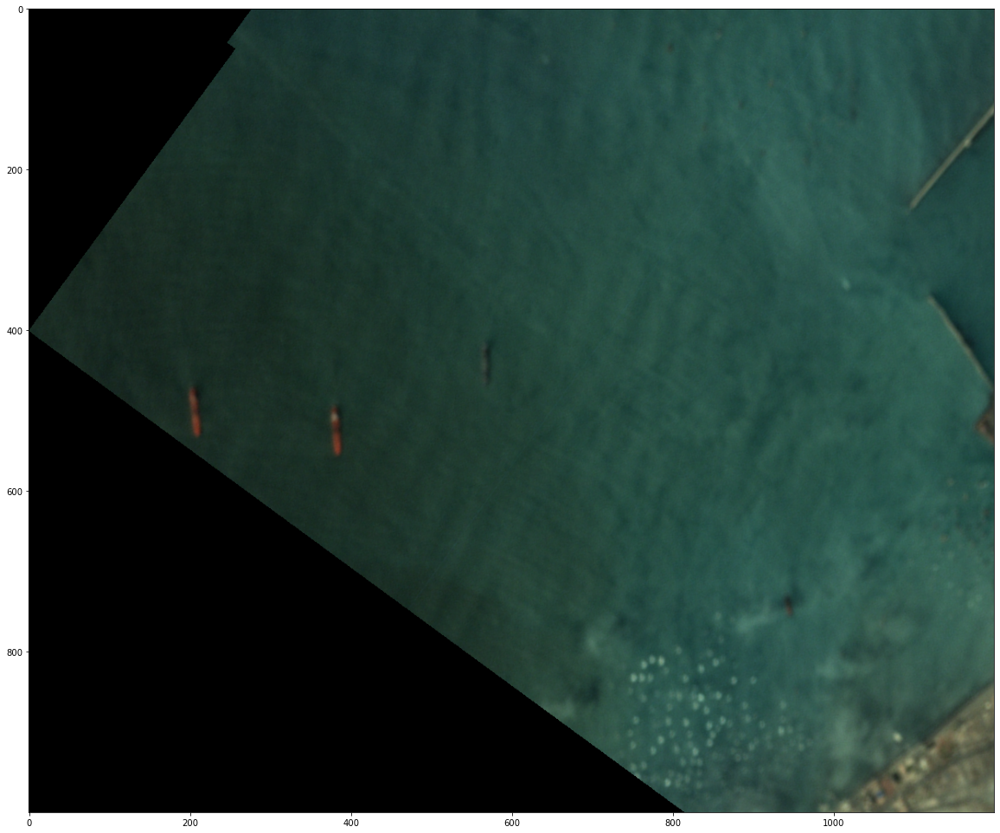

In [237]:
x_start = 0
x_end = 1200
y_start = 1250
y_end = 2250

section = img[y_start:y_end, x_start:x_end,:]
plt.figure(figsize=(20,20))
plt.imshow(section)

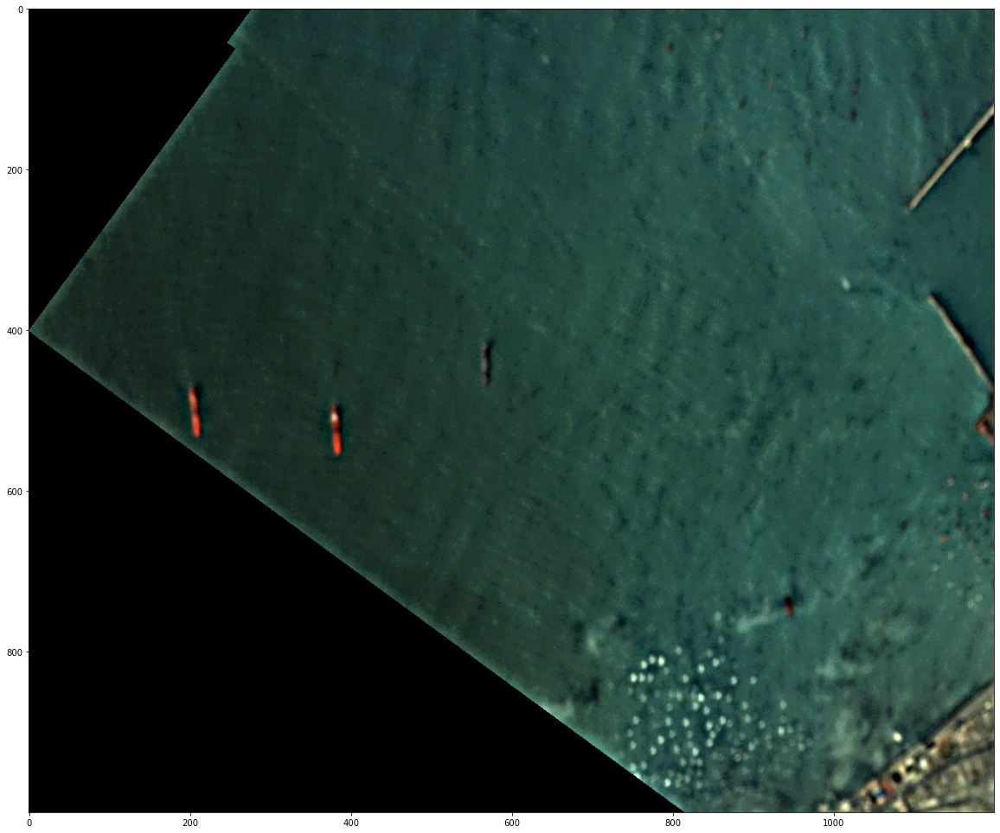

In [267]:
from PIL import Image, ImageFilter

im = Image.fromarray(section)

im2 = change_contrast(im, 0)
im2 = im2.filter(ImageFilter.UnsharpMask(radius=9.0, percent=200))
im_array = np.array(im)
im2_array = np.array(im2)

plt.figure(figsize=(20,20))
plt.imshow(im2_array)

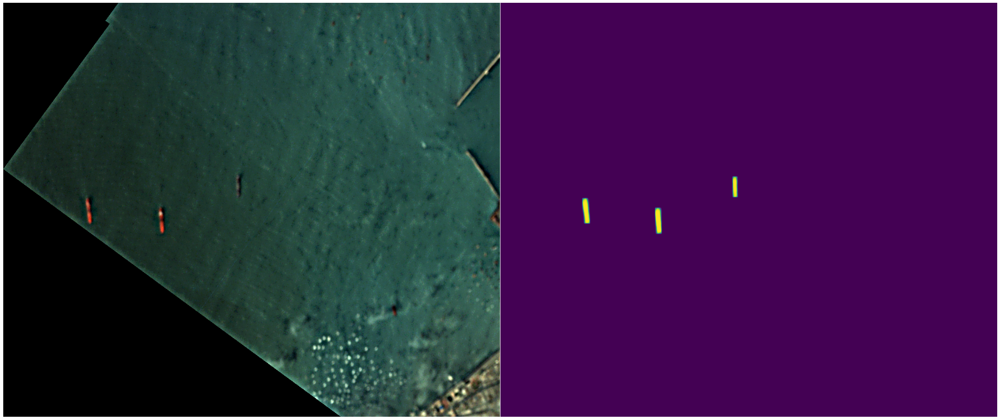

In [268]:
from torchvision.transforms import functional as F
img_crop =im2_array

image = F.to_tensor(img_crop)
model.eval()
with torch.no_grad():
    #prediction = model([img_torch.to(device)])
    prediction = model([(image).to(device)])
    
import matplotlib.pyplot as plt
from PIL import Image


#img = Image.fromarray(np.array((img_array[0, :, :, None]), dtype=int))

n_pos = len(prediction[0]['scores'][(prediction[0]['scores'] > 0.00)])

masks = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
for mask in prediction[0]['masks'][1:n_pos, 0]:
    masks += mask.mul(255).byte().cpu().numpy()

fig, axarr = plt.subplots(1, 2, figsize=(30, 80))
axarr[0].axis('off')
axarr[1].axis('off')
#axarr[2].axis('off')
#axarr[3].axis('off')
axarr[0].imshow(Image.fromarray(img_crop))#, cmap='Blues')
axarr[1].imshow(Image.fromarray(masks))
#axarr[2].imshow(img)
#axarr[2].imshow(all_masks, alpha=0.4)
#axarr[3].imshow(first_mask)
plt.tight_layout(h_pad=0.1, w_pad=0.1)
plt.show()

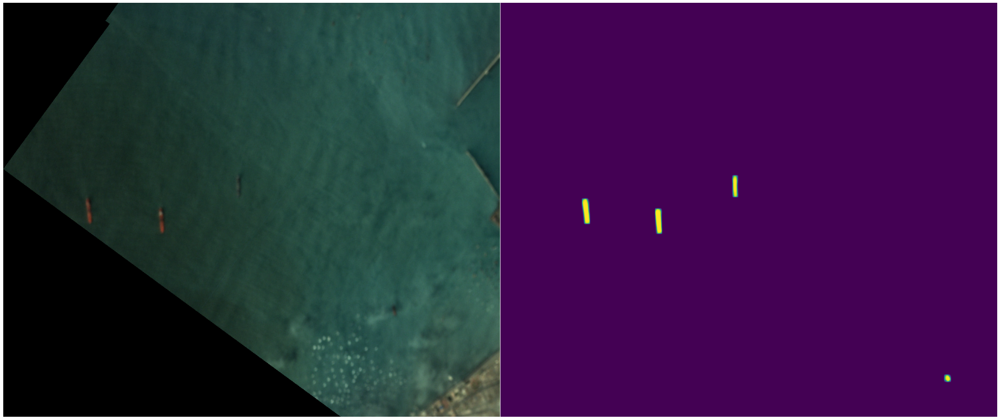

In [269]:
from torchvision.transforms import functional as F
img_crop = im_array

image = F.to_tensor(img_crop)
model.eval()
with torch.no_grad():
    #prediction = model([img_torch.to(device)])
    prediction = model([(image).to(device)])
    
import matplotlib.pyplot as plt
from PIL import Image


#img = Image.fromarray(np.array((img_array[0, :, :, None]), dtype=int))

n_pos = len(prediction[0]['scores'][(prediction[0]['scores'] > 0.00)])

masks = prediction[0]['masks'][0, 0].mul(255).byte().cpu().numpy()
for mask in prediction[0]['masks'][1:n_pos, 0]:
    masks += mask.mul(255).byte().cpu().numpy()

fig, axarr = plt.subplots(1, 2, figsize=(30, 80))
axarr[0].axis('off')
axarr[1].axis('off')
#axarr[2].axis('off')
#axarr[3].axis('off')
axarr[0].imshow(Image.fromarray(img_crop))#, cmap='Blues')
axarr[1].imshow(Image.fromarray(masks))
#axarr[2].imshow(img)
#axarr[2].imshow(all_masks, alpha=0.4)
#axarr[3].imshow(first_mask)
plt.tight_layout(h_pad=0.1, w_pad=0.1)
plt.show()